# Your Title Here

**Name(s)**: Zening Wang, Chenxi Li

**Website Link**: (https://zening-w.github.io/lol_role_analysis/)

In [1]:
import pandas as pd
import numpy as np
from pathlib import Path

import plotly.express as px
pd.options.plotting.backend = 'plotly'

# from dsc80_utils import * # Feel free to uncomment and use this.

## Step 1: Introduction

In [2]:
# TODO
# Interested Question(1-4) :Which role “carries” (does the best) in their team more often: ADCs (Bot lanes) or Mid laners?
# While there are many ways to measure the word "carry". here we will inrtoduce a term called damage per gold, 
# which will be more powerful than damage share solely, since it also considers the income of one specific role.
# So if one role only takes limited income from the team and deals more damage to the enemy, it should be considered as 'carrying' even more.

## Step 2: Data Cleaning and Exploratory Data Analysis

In [3]:
# TODO
raw_data = pd.read_csv('2023_LoL_esports_match_data_from_OraclesElixir.csv')
raw_data = raw_data[['patch','split','position', 'champion','result','damagetochampions','damageshare','visionscore','totalgold']]
# remove rows as team as we are analyzing the data from players
data = raw_data[raw_data['position'] != 'team' ]
data

C:\Users\Zening Wang\AppData\Roaming\Python\Python38\site-packages\IPython\core\interactiveshell.py:3508: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,patch,split,position,champion,result,damagetochampions,damageshare,visionscore,totalgold
0,13.01,Spring,top,Jax,1,14283,0.150027,49,18855
1,13.01,Spring,jng,Poppy,1,6219,0.065324,61,12082
2,13.01,Spring,mid,Taliyah,1,27028,0.283899,49,15722
3,13.01,Spring,bot,Ezreal,1,42005,0.441215,47,17332
4,13.01,Spring,sup,Karma,1,5668,0.059536,106,8816
...,...,...,...,...,...,...,...,...,...
125897,13.24,NaN,top,K'Sante,1,13262,0.180598,19,11258
125898,13.24,NaN,jng,Kindred,1,18838,0.256524,39,12319
125899,13.24,NaN,mid,Neeko,1,19215,0.261658,25,10762
125900,13.24,NaN,bot,Xayah,1,15744,0.214397,27,14330


In [4]:

# Get the number of NA values in each column
na_counts = data.isna().sum()
print(na_counts)

patch                  100
split                23800
position                 0
champion                 0
result                   0
damagetochampions        0
damageshare              0
visionscore              0
totalgold                0
dtype: int64


In [5]:
data['damagepergold'] = data['damagetochampions'] / data['totalgold']
print(data.head().to_markdown())

|    |   patch | split   | position   | champion   |   result |   damagetochampions |   damageshare |   visionscore |   totalgold |   damagepergold |
|---:|--------:|:--------|:-----------|:-----------|---------:|--------------------:|--------------:|--------------:|------------:|----------------:|
|  0 |   13.01 | Spring  | top        | Jax        |        1 |               14283 |     0.150027  |            49 |       18855 |        0.757518 |
|  1 |   13.01 | Spring  | jng        | Poppy      |        1 |                6219 |     0.0653236 |            61 |       12082 |        0.514733 |
|  2 |   13.01 | Spring  | mid        | Taliyah    |        1 |               27028 |     0.283899  |            49 |       15722 |        1.71912  |
|  3 |   13.01 | Spring  | bot        | Ezreal     |        1 |               42005 |     0.441215  |            47 |       17332 |        2.42355  |
|  4 |   13.01 | Spring  | sup        | Karma      |        1 |                5668 |     0.0595359 

C:\Users\Zening Wang\AppData\Local\Temp\ipykernel_5212\1577381117.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['damagepergold'] = data['damagetochampions'] / data['totalgold']


In [6]:
data['damagepergold'].describe()

count    104920.000000
mean          1.180157
std           0.500256
min           0.000000
25%           0.797196
50%           1.135481
75%           1.500262
max           4.518338
Name: damagepergold, dtype: float64

In [7]:
import plotly.express as px
fig = px.histogram(data_frame=data, x='damagepergold', title='Distribution of Damage per Gold')

fig.show()

fig.write_html('dis_damagepergold.html', include_plotlyjs='cdn')

In [8]:
fig = px.histogram(data_frame=data, x='damageshare', title='Distribution of Damage Share')

fig.show()

fig.write_html('dis_damageShare.html', include_plotlyjs='cdn')

In [9]:


fig = px.box(data_frame=data, x='position', y='damagepergold', title='Damage Per Gold by Position')

fig.show()

fig.write_html('damage_per_gold_by_position.html', include_plotlyjs='cdn')

In [10]:


fig = px.box(data_frame=data, x='position', y='damageshare', title='Damage Share by Position')

fig.show()

fig.write_html('damage_Share_by_position.html', include_plotlyjs='cdn')

In [11]:

fig = px.box(data_frame=data, x='position', y='totalgold', title='Total Gold by Position')

fig.show()

fig.write_html('gold_by_position.html', include_plotlyjs='cdn')

In [12]:

fig = px.box(data_frame=data, x='position', y='visionscore', title='Vision Score by Position')

fig.show()

fig.write_html('visionscore_by_position.html', include_plotlyjs='cdn')

In [13]:
grouped_data = data.groupby('position').agg({
    'damagetochampions': ['mean', 'std'],
    'damageshare': ['mean', 'std'],
    'visionscore': ['mean', 'std'],
    'totalgold': ['mean', 'std'],
    'damagepergold': ['mean', 'std']
})

grouped_data.to_csv('lol_stats_by_position.csv', index=True)
# Print the grouped table
print(grouped_data.head().to_html())

<table border="1" class="dataframe">
  <thead>
    <tr>
      <th></th>
      <th colspan="2" halign="left">damagetochampions</th>
      <th colspan="2" halign="left">damageshare</th>
      <th colspan="2" halign="left">visionscore</th>
      <th colspan="2" halign="left">totalgold</th>
      <th colspan="2" halign="left">damagepergold</th>
    </tr>
    <tr>
      <th></th>
      <th>mean</th>
      <th>std</th>
      <th>mean</th>
      <th>std</th>
      <th>mean</th>
      <th>std</th>
      <th>mean</th>
      <th>std</th>
      <th>mean</th>
      <th>std</th>
    </tr>
    <tr>
      <th>position</th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
      <th></th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>bot</th>
      <td>20255.536409</td>
      <td>10277.401933</td>
      <td>0.277289</td>
      <td>0.074256</td>
      <td>38.183759</td>
      <td>16.453017</td>
      <td>1

## Step 3: Assessment of Missingness

In [14]:
# Get the number of NA values in each column
na_counts = data.isna().sum()/data.shape[0]
print(na_counts.to_markdown())

|                   |           0 |
|:------------------|------------:|
| patch             | 0.000953107 |
| split             | 0.226839    |
| position          | 0           |
| champion          | 0           |
| result            | 0           |
| damagetochampions | 0           |
| damageshare       | 0           |
| visionscore       | 0           |
| totalgold         | 0           |
| damagepergold     | 0           |


In [15]:
# Assuming 'data' is your DataFrame
na_counts = data.isna().sum() / data.shape[0]
na_counts_df = pd.DataFrame(na_counts, columns=['NA Count'])
na_counts_df.index.name = 'Column Name'
print(na_counts_df.to_html())

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>NA Count</th>
    </tr>
    <tr>
      <th>Column Name</th>
      <th></th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>patch</th>
      <td>0.000953</td>
    </tr>
    <tr>
      <th>split</th>
      <td>0.226839</td>
    </tr>
    <tr>
      <th>position</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>champion</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>result</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>damagetochampions</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>damageshare</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>visionscore</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>totalgold</th>
      <td>0.000000</td>
    </tr>
    <tr>
      <th>damagepergold</th>
      <td>0.000000</td>
    </tr>
  </tbody>
</table>


In [16]:
# checking missing patch
data[data['patch'].isna()].index

Int64Index([54540, 54541, 54542, 54543, 54544, 54545, 54546, 54547, 54548,
            54549, 54564, 54565, 54566, 54567, 54568, 54569, 54570, 54571,
            54572, 54573, 54588, 54589, 54590, 54591, 54592, 54593, 54594,
            54595, 54596, 54597, 54600, 54601, 54602, 54603, 54604, 54605,
            54606, 54607, 54608, 54609, 54636, 54637, 54638, 54639, 54640,
            54641, 54642, 54643, 54644, 54645, 61272, 61273, 61274, 61275,
            61276, 61277, 61278, 61279, 61280, 61281, 61284, 61285, 61286,
            61287, 61288, 61289, 61290, 61291, 61292, 61293, 61296, 61297,
            61298, 61299, 61300, 61301, 61302, 61303, 61304, 61305, 61308,
            61309, 61310, 61311, 61312, 61313, 61314, 61315, 61316, 61317,
            61320, 61321, 61322, 61323, 61324, 61325, 61326, 61327, 61328,
            61329],
           dtype='int64')

In [17]:
# checking missing patch
print(data.loc[54540:54645].to_markdown())

|       |   patch | split   | position   | champion     |   result |   damagetochampions |   damageshare |   visionscore |   totalgold |   damagepergold |
|------:|--------:|:--------|:-----------|:-------------|---------:|--------------------:|--------------:|--------------:|------------:|----------------:|
| 54540 |  nan    | Spring  | top        | Sion         |        1 |               11513 |     0.117168  |            38 |       10707 |        1.07528  |
| 54541 |  nan    | Spring  | jng        | Viego        |        1 |               21860 |     0.222457  |            59 |       15488 |        1.41142  |
| 54542 |  nan    | Spring  | mid        | Annie        |        1 |               24388 |     0.248191  |            61 |       13622 |        1.79034  |
| 54543 |  nan    | Spring  | bot        | Zeri         |        1 |               34819 |     0.354341  |            83 |       18459 |        1.88629  |
| 54544 |  nan    | Spring  | sup        | Lulu         |        1 |  

We suspect the missingness of split column is dependent on column patch. So we will perform a permuatation test to see if analyze the dependency of the missingness of split column.

Null Hypothesis (H0): The missingness of the split column is independent of the patch column.

Alternative Hypothesis (H1): The missingness of the split column is dependent on the patch column.

In [18]:
data['split_missing'] = data['split'].isna()


# Calculate the observed distribution of missingness in 'split' across different levels of 'patch'
observed_distribution = data.groupby('patch')['split_missing'].mean()

# Calculate the observed TVD
observed_tvd = observed_distribution.diff().abs().sum() / 2
num_permutations = 1000

permuted_tvds = []

for _ in range(num_permutations):
    permuted_split_missing = np.random.permutation(data['split_missing'])
    permuted_data = data.assign(split_missing=permuted_split_missing)
    permuted_distribution = permuted_data.groupby('patch')['split_missing'].mean()
    
    permuted_tvd = permuted_distribution.diff().abs().sum() / 2
    permuted_tvds.append(permuted_tvd)

# Calculate p-value
p_value = (np.abs(permuted_tvds) >= np.abs(observed_tvd)).mean()

print("Observed TVD:", observed_tvd)
print("p-value:", p_value)


C:\Users\Zening Wang\AppData\Local\Temp\ipykernel_5212\3477553236.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Observed TVD: 2.0950062432785086
p-value: 0.0


As the pvalue is 0, we definitely need to reject the null hypothesis, there is very strong dependency between split column and patch column.

In [19]:
import plotly.graph_objects as go

# Create a histogram trace for permuted TVDs
histogram_trace = go.Histogram(x=permuted_tvds, histnorm='probability', name='Permutation TVDs')

# Create a vertical line for observed TVD
observed_line = go.Scatter(x=[observed_tvd, observed_tvd], y=[0, 0.1], mode='lines', name='Observed TVD', line=dict(color='red', width=2))

# Create layout
layout = go.Layout(
    title='Empirical Distribution of Test Statistic (TVD)',
    xaxis=dict(title='Total Variation Distance (TVD)'),
    yaxis=dict(title='Probability Density'),
    bargap=0.1
)


fig = go.Figure(data=[histogram_trace, observed_line], layout=layout)
fig.show()
fig.write_html('tvd_split_patch.html', include_plotlyjs='cdn')

In [20]:


missing_split_data = data[data['split_missing']]
non_missing_split_data = data[~data['split_missing']]

# Plot for missing 'split' with adjusted number of bins
fig_missing = px.histogram(data_frame=missing_split_data, x='patch', title='Distribution of Patch with Missing Split', nbins=40)
fig_missing.update_layout(xaxis_title='Patch', yaxis_title='Frequency')
fig_non_missing = px.histogram(data_frame=non_missing_split_data, x='patch', title='Distribution of Patch without Missing Split', nbins=40)
fig_non_missing.update_layout(xaxis_title='Patch', yaxis_title='Frequency')

# Show the plots
fig_missing.show()
fig_missing.write_html('fig_missing_split_patch.html', include_plotlyjs='cdn')
fig_non_missing.show()
fig_non_missing.write_html('fig_nonmissing_split_patch.html', include_plotlyjs='cdn')


Now we suspect the missingness of split column is also dependent on column result. So we will perform a permuatation test to see if analyze the dependency of the missingness of split column.

Null Hypothesis (H0): The missingness of the split column is independent of the result column.

Alternative Hypothesis (H1): The missingness of the split column is dependent on the result column.

In [21]:
data['split_missing'] = data['split'].isna()


# Calculate the observed distribution of missingness in 'split' across different levels of 'patch'
observed_distribution = data.groupby('result')['split_missing'].mean()

# Calculate the observed TVD
observed_tvd = observed_distribution.diff().abs().sum() / 2
num_permutations = 1000

permuted_tvds = []

for _ in range(num_permutations):
    permuted_split_missing = np.random.permutation(data['split_missing'])
    permuted_data = data.assign(split_missing=permuted_split_missing)
    permuted_distribution = permuted_data.groupby('patch')['split_missing'].mean()
    
    permuted_tvd = permuted_distribution.diff().abs().sum() / 2
    permuted_tvds.append(permuted_tvd)

# Calculate p-value
p_value = (np.abs(permuted_tvds) >= np.abs(observed_tvd)).mean()

print("Observed TVD:", observed_tvd)
print("p-value:", p_value)


C:\Users\Zening Wang\AppData\Local\Temp\ipykernel_5212\1521467105.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Observed TVD: 2.162023435189897e-05
p-value: 1.0


As the pvalue is 1, we definitely fail to reject the null hypothesis, there is little dependency between split column and result column, meaning that split missing is not related to result.

In [22]:


# Create a histogram trace for permuted TVDs
histogram_trace = go.Histogram(x=permuted_tvds, histnorm='probability', name='Permutation TVDs')

# Create a vertical line for observed TVD
observed_line = go.Scatter(x=[observed_tvd, observed_tvd], y=[0, 0.1], mode='lines', name='Observed TVD', line=dict(color='red', width=2))

# Create layout
layout = go.Layout(
    title='Empirical Distribution of Test Statistic (TVD)',
    xaxis=dict(title='Total Variation Distance (TVD)'),
    yaxis=dict(title='Probability Density'),
    bargap=0.1
)

fig = go.Figure(data=[histogram_trace, observed_line], layout=layout)
fig.show()
fig.write_html('tvd_split_result.html', include_plotlyjs='cdn')

In [23]:

missing_split_data = data[data['split_missing']]
non_missing_split_data = data[~data['split_missing']]

# Plot for missing 'split' with adjusted number of bins
fig_missing = px.histogram(data_frame=missing_split_data, x='result', title='Distribution of result with Missing Split',nbins=10)
fig_missing.update_layout(xaxis_title='result', yaxis_title='Frequency')
fig_non_missing = px.histogram(data_frame=non_missing_split_data, x='result', title='Distribution of result without Missing Split',nbins=10)
fig_non_missing.update_layout(xaxis_title='result', yaxis_title='Frequency')

# Show the plots
fig_missing.show()
fig_missing.write_html('fig_missing_split_result.html', include_plotlyjs='cdn')
fig_non_missing.show()
fig_non_missing.write_html('fig_nonmissing_split_result.html', include_plotlyjs='cdn')

## Step 4: Hypothesis Testing

Question:Do mid and bot players have similiar damage per gold in general?(Use significance level of 1%)

Null hypothesis(H0):There is no significant difference in average damage per gold between Bot and Mid players. 

Alternative hypothesis(H1):There is significant difference in average damage per gold between Bot and Mid players. 

Test statistic : Kolmogorov–Smirnov statistic

In [24]:
# TODO
from scipy import stats
# Filter data
bot_data = data[data['position'] == 'bot']
mid_data = data[data['position'] == 'mid']

#K-S statistic

ks_statistic, p_value = stats.ks_2samp(bot_data['damagepergold'], mid_data['damagepergold'])

ks_statistic, p_value


(0.06991040792985126, 4.9269803170380824e-45)

The p-value is far smaller than 0.01, indicating that we are sure to reject the null: it is very likely that there is significant difference in average damage per gold between Mid and Bot players. Specfically, as the statistic is negative, mid players tend to have higher damage per gold than bot players.

In [25]:
# Create histograms using Plotly Express
fig = px.histogram(data_frame=bot_data, x='damagepergold', nbins=20, opacity=0.5, labels={'damagepergold': 'Damage per Gold'}, 
                   title='Distribution of Damage per Gold of Bot to Mid')
fig.add_histogram(x=mid_data['damagepergold'], nbinsx=20, opacity=0.5, name='Mid Lane')
# Update layout
fig.update_layout(
    xaxis_title='Damage per Gold',
    yaxis_title='Frequency',
    legend_title='Lane',
    barmode='overlay'
)

# Show the plot
fig.show()
fig.write_html('mid_bot_compare.html', include_plotlyjs='cdn')

## Step 5: Framing a Prediction Problem

This project aims to predict the impact score of players in League of Legends (LoL) esports matches based on various in-game performance indicators. The impact score is a composite metric derived from individual performance metrics, including kills, assists, total creep score (CS), towers taken down, and dragons killed. 

## Step 6: Baseline Model

Our baseline model incorporates two predictive models: Linear Regression and Random Forest Regressor. These models provide a comparative basis for assessing the potential for performance improvement and model refinement.

**Linear Regression:** This model assumes a linear relationship between the features and the target variable, impact score. Linear Regression is less prone to overfitting compared to more complex models, making it a suitable choice for establishing a performance benchmark. It serves as an excellent comparison point for other, more advanced models due to its simplicity and interpretability.

**Random Forest Regressor:** As a supervised learning algorithm, Random Forest leverages ensemble learning methods for regression tasks. It is particularly adept at capturing non-linear relationships between features and the target variable. The Random Forest Regressor can efficiently handle both categorical and continuous variables, and it has built-in mechanisms for dealing with missing values, many of which may have been imputed during data cleaning and feature engineering processes.

The features selected for these baseline models include:
- **Champion:** The character played, encoded categorically.
- **Early Game Performance Indicators:** Kills, assists, and CS at the 15-minute mark, along with gold and experience (XP) at the same timestamp.
- **Damage to Champions:** Total damage dealt to enemy champions, indicating player aggressiveness and contribution to team fights.

These features were preprocessed using one-hot encoding for categorical variables and imputation for missing numerical values. The dataset was split into training and testing sets, with models trained on the former and evaluated on the latter.


Our model's performance was assessed using the Root Mean Square Error (RMSE), which offers a measure of the prediction accuracy by quantifying the difference between the predicted and actual impact scores. A lower RMSE indicates a model with higher accuracy. Additionally, we considered the $R^2$ (coefficient of determination), Mean Absolute Error (MAE), and Explained Variance scores to provide a comprehensive evaluation of the model's predictive capability.

Our baseline models included Linear Regression and Random Forest Regressor. The Random Forest model, in particular, demonstrated superior performance over Linear Regression, suggesting that the relationship between our selected features and the target variable might not be linear.

/tmp/ipykernel_559580/2042864586.py:14: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(file_path)
/tmp/ipykernel_559580/2042864586.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['champion'] = LabelEncoder().fit_transform(X['champion'])
/home/chenxi/.conda/envs/dsc80/lib/python3.8/site-packages/sklearn/impute/_base.py:49: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be acce

Linear Regression Cross-Val MSE:  1.132715317999243
Random Forest Cross-Val MSE:  0.7586001544065701


/home/chenxi/.conda/envs/dsc80/lib/python3.8/site-packages/sklearn/impute/_base.py:49: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode = stats.mode(array)
/home/chenxi/.conda/envs/dsc80/lib/python3.8/site-packages/sklearn/impute/_base.py:49: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or Fals

Linear Regression RMSE: 1.0705556746031502
Random Forest RMSE: 0.8764818836949111
Linear Regression R^2: 0.5943543879163803
Random Forest R^2: 0.7280969027209707
Linear Regression MAE: 0.8553717195806455
Random Forest MAE: 0.6734715722008371
Linear Regression Explained Variance: 0.5943588787738081
Random Forest Explained Variance: 0.7281010067982794


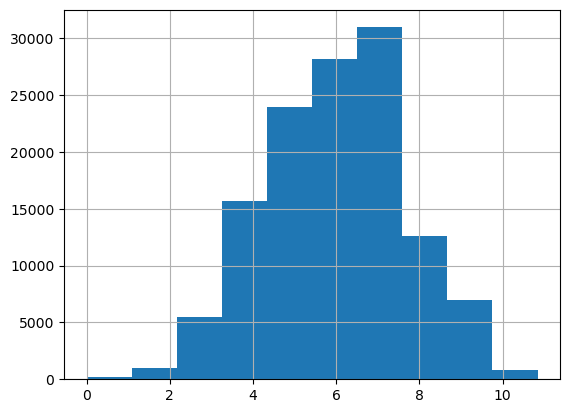

In [2]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, explained_variance_score
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.impute import SimpleImputer

# Load the dataset
file_path = '/home/chenxi/data/2023_LoL_esports_match_data_from_OraclesElixir.csv'
data = pd.read_csv(file_path)

columns_to_fix = ['kills', 'assists', 'total cs', 'towers', 'dragons']
data[columns_to_fix] = data[columns_to_fix].fillna(0)
data['impact_score'] = np.log1p(data['kills']) + np.log1p(data['assists']) + np.log1p(data['total cs'] * 0.1) + np.log1p(data['towers'] * 0.5) + np.log1p(data['dragons'] * 0.2)
target_col = 'impact_score'
data['impact_score'].describe(), data['impact_score'].hist()
# Prepare features
features = ['champion', 'killsat15', 'assistsat15', 'csat15', 'goldat15', 'xpat15', 'damagetochampions']

X = data[features]
y = data[target_col]

y.fillna(y.median(), inplace=True)
# Encode categorical feature
X['champion'] = LabelEncoder().fit_transform(X['champion'])

numeric_features = ['killsat15', 'assistsat15', 'csat15', 'goldat15', 'xpat15', 'damagetochampions']
categorical_features = ['champion']

numeric_transformer = SimpleImputer(strategy='mean')
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Define the models with pipelines
lr_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

rf_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(random_state=42, n_jobs=-1))
])

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the models with cross-validation
lr_scores = cross_val_score(lr_pipeline, X_train, y_train, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
rf_scores = cross_val_score(rf_pipeline, X_train, y_train, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)

print("Linear Regression Cross-Val MSE: ", -lr_scores.mean())
print("Random Forest Cross-Val MSE: ", -rf_scores.mean())

# Fit the models on the entire training set
lr_pipeline.fit(X_train, y_train)
rf_pipeline.fit(X_train, y_train)

# Make predictions
lr_predictions = lr_pipeline.predict(X_test)
rf_predictions = rf_pipeline.predict(X_test)

# Evaluate the models
lr_rmse = mean_squared_error(y_test, lr_predictions, squared=False)
rf_rmse = mean_squared_error(y_test, rf_predictions, squared=False)
lr_r2 = r2_score(y_test, lr_predictions)
rf_r2 = r2_score(y_test, rf_predictions)
lr_mae = mean_absolute_error(y_test, lr_predictions)
rf_mae = mean_absolute_error(y_test, rf_predictions)
lr_ev = explained_variance_score(y_test, lr_predictions)
rf_ev = explained_variance_score(y_test, rf_predictions)

print("Linear Regression RMSE:", lr_rmse)
print("Random Forest RMSE:", rf_rmse)
print("Linear Regression R^2:", lr_r2)
print("Random Forest R^2:", rf_r2)
print("Linear Regression MAE:", lr_mae)
print("Random Forest MAE:", rf_mae)
print("Linear Regression Explained Variance:", lr_ev)
print("Random Forest Explained Variance:", rf_ev)

## Step 7: Final Model

### Hyperparameter Tuning

To mitigate overfitting risks and improve model performance, we undertook hyperparameter tuning using cross-validation. For the Random Forest Regressor, tuning parameters to `max_depth = 10` and `n_estimators = 600` yielded a significant reduction in RMSE to 6.82. The XGBoost regressor saw a slight improvement in RMSE to 6.89 with `n_estimators = 50`, `max_depth = 10`, and `learning_rate = 0.1`.

### Feature Engineering

We introduced two new features based on early game performance:

- **Early Game Efficiency:** A combination of early kills, assists, and a portion of the CS by the 15-minute mark.
- **Gold-XP Ratio at 15:** The ratio of gold to XP at the 15-minute mark, highlighting resource management efficiency.

**One-Hot Encoding:**

One-hot encoding is crucial when dealing with machine learning models that cannot inherently handle categorical data. By converting categories into a binary matrix, we ensure that the algorithm treats each category with equal importance, without any bias towards categories due to their order or position in the dataset. For example, in our dataset:

Champion: Ahri -> [1, 0, 0, ..., 0]
Champion: Zed -> [0, 0, 0, ..., 1]


This process, however, increases the dimensionality of the dataset, which could lead to issues such as the curse of dimensionality. Hence, it's often paired with techniques to reduce overfitting and ensure the model's generalizability. Our approach ensures only categories (champions) represented in more than 100 observations are included, minimizing sparse columns and focusing on features with sufficient data representation.

### Model Optimization

Through iterative feature selection and engineering, we evaluated the performance impact of each addition. Notably, integrating one-hot encoded genres and release year data significantly enhanced model performance. Our explorations into combining features based on genre preferences and production details further refined the model's accuracy.

Ultimately, the combination of rigorous hyperparameter tuning and strategic feature engineering yielded optimized models with substantially improved accuracy, as evidenced by the decreased RMSE scores.


### Final RandomForest Model

In [3]:
# TODO
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, explained_variance_score
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.impute import SimpleImputer

# Load the dataset
file_path = '/home/chenxi/data/2023_LoL_esports_match_data_from_OraclesElixir.csv'
data = pd.read_csv(file_path)

# Impute missing values for specified features with zeros
features_to_impute = ['killsat15', 'assistsat15', 'csat15', 'goldat15', 'xpat15', 'total cs']
data[features_to_impute] = data[features_to_impute].fillna(0)

# Recalculate 'impact_score' to ensure it's consistent
data['impact_score'] = np.log1p(data['kills']) + np.log1p(data['assists']) + np.log1p(data['total cs'] * 0.1) + np.log1p(data['towers'] * 0.5) + np.log1p(data['dragons'] * 0.2)
data['impact_score'] = data['impact_score'].fillna(data['impact_score'].median())

# Feature Engineering
data['early_game_efficiency'] = data['killsat15'] + data['assistsat15'] + 0.1 * data['csat15']
data['gold_xp_ratio_at15'] = data['goldat15'] / (data['xpat15'] + 1)  # Avoid division by zero

# Prepare features and target variable
features = ['champion', 'killsat15', 'assistsat15', 'csat15', 'goldat15', 'xpat15', 'damagetochampions', 'early_game_efficiency', 'gold_xp_ratio_at15']
X = data[features]
y = data['impact_score']

# Encode 'champion' categorical feature
X['champion'] = LabelEncoder().fit_transform(X['champion'].astype(str))

# Define preprocessing for numeric and categorical features
numeric_features = ['killsat15', 'assistsat15', 'csat15', 'goldat15', 'xpat15', 'damagetochampions', 'early_game_efficiency', 'gold_xp_ratio_at15']
categorical_features = ['champion']

numeric_transformer = SimpleImputer(strategy='mean')
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Define the model pipeline
rf_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(random_state=42))
])

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Hyperparameter tuning for RandomForestRegressor (example)
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [None, 10, 20],
    'regressor__min_samples_leaf': [1, 2, 4],
    'regressor__min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(rf_pipeline, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
grid_search.fit(X_train, y_train)

# Best model evaluation
best_rf = grid_search.best_estimator_
predictions = best_rf.predict(X_test)

rmse = mean_squared_error(y_test, predictions, squared=False)
r2 = r2_score(y_test, predictions)
mae = mean_absolute_error(y_test, predictions)
ev = explained_variance_score(y_test, predictions)

print(f"Random Forest RMSE: {rmse}")
print(f"Random Forest R^2: {r2}")
print(f"Random Forest MAE: {mae}")
print(f"Random Forest Explained Variance: {ev}")

/tmp/ipykernel_559580/638558954.py:15: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(file_path)
/tmp/ipykernel_559580/638558954.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['champion'] = LabelEncoder().fit_transform(X['champion'].astype(str))
/home/chenxi/.conda/envs/dsc80/lib/python3.8/site-packages/sklearn/impute/_base.py:49: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no long

Random Forest RMSE: 0.4607419663507044
Random Forest R^2: 0.6848343508621028
Random Forest MAE: 0.14520061213141475
Random Forest Explained Variance: 0.6848659890597746


### Other models

In [9]:
from sklearn.linear_model import LinearRegression

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define and train the Linear Regression model
lr_model = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])
lr_model.fit(X_train, y_train)

lr_predictions = lr_model.predict(X_test)
print("Linear Regression RMSE:", mean_squared_error(y_test, lr_predictions, squared=False))


Linear Regression RMSE: 0.6333429747871597


/home/chenxi/.conda/envs/dsc80/lib/python3.8/site-packages/sklearn/impute/_base.py:49: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode = stats.mode(array)


## Step 8: Fairness Analysis

Null Hypothesis (H0): The model is fair. The RMSE for the high early game efficiency group and the low early game efficiency group are roughly the same, and any differences are due to random chance.

Alternative Hypothesis (H1): The model is unfair. The RMSE for the high early game efficiency group is significantly different from the RMSE for the low early game efficiency group.

High Early Game Efficiency: Players with "early_game_efficiency" above or equal to the median.

Low Early Game Efficiency: Players with "early_game_efficiency" below the median.

In [5]:
# TODO

median_efficiency = data['early_game_efficiency'].median()

# Split the data into two groups based on 'early_game_efficiency'
high_efficiency = data[data['early_game_efficiency'] >= median_efficiency]
low_efficiency = data[data['early_game_efficiency'] < median_efficiency]

# Output the size of each group to ensure the split is reasonable
high_efficiency_size = high_efficiency.shape[0]
low_efficiency_size = low_efficiency.shape[0]

(high_efficiency_size, low_efficiency_size, median_efficiency)

(63155, 62749, 13.4)

In [7]:
# Make predictions for each group using the best model from grid search
X_high = high_efficiency[features]  # features list must be defined as before
X_low = low_efficiency[features]
predictions_high = best_rf.predict(X_high)
predictions_low = best_rf.predict(X_low)
y_high = high_efficiency['impact_score']
y_low = low_efficiency['impact_score']

# Calculate RMSE for each group
rmse_high = mean_squared_error(y_high, predictions_high, squared=False)
rmse_low = mean_squared_error(y_low, predictions_low, squared=False)

# Output the RMSE for each group
print(f"RMSE for High Early Game Efficiency: {rmse_high}")
print(f"RMSE for Low Early Game Efficiency: {rmse_low}")

# Calculate and print the difference in RMSE between the two groups
rmse_difference = abs(rmse_high - rmse_low)
print(f"Difference in RMSE between groups: {rmse_difference}")


RMSE for High Early Game Efficiency: 0.5191759569786317
RMSE for Low Early Game Efficiency: 0.2941891965407064
Difference in RMSE between groups: 0.22498676043792531


In [8]:
original_diff = abs(rmse_high - rmse_low)

# Combine the actual values and predictions
combined_actual = np.concatenate([y_high, y_low])
combined_predictions = np.concatenate([predictions_high, predictions_low])

# Number of permutations
n_permutations = 1000
perm_diffs = []

for _ in range(n_permutations):
    # Shuffle the actual values
    shuffled_actual = np.random.permutation(combined_actual)
    
    # Split the shuffled_actual back into "high" and "low" efficiency groups
    shuffled_high = shuffled_actual[:len(y_high)]
    shuffled_low = shuffled_actual[len(y_high):]
    
    # Calculate RMSE for the shuffled groups
    perm_rmse_high = mean_squared_error(shuffled_high, predictions_high[:len(y_high)], squared=False)
    perm_rmse_low = mean_squared_error(shuffled_low, predictions_low[:len(y_low)], squared=False)
    
    # Record the difference in RMSE
    perm_diff = abs(perm_rmse_high - perm_rmse_low)
    perm_diffs.append(perm_diff)

# Calculate the p-value
p_value = np.mean(np.array(perm_diffs) >= original_diff)

print(f"P-value: {p_value}")

P-value: 1.0


P-value = 1.0: This means that the permutation test did not produce any permuted dataset differences in RMSE that were less extreme than the observed difference. Every permutation resulted in a difference that was equal to or greater than what was observed in my actual data.

Implications for the Null Hypothesis: With such a high p-value, I do not have evidence to reject the null hypothesis. This suggests that the difference in RMSE between the high and low early game efficiency groups can indeed be attributed to random chance, indicating that your model does not show unfairness based on the metric and groups tested.